<a href="https://colab.research.google.com/github/BigBroCat/Lab/blob/main/ExtractingSpectrogramsFromAudioWithPython.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import librosa.display
import IPython.display as ipd
import numpy as np
import matplotlib.pyplot as plt#导入各种数据库

## Loading audio files with Librosa

In [2]:
scale_file = 'audio/scale.wav'#将文件路径赋值给
debussy_file = 'audio/debussy.wav'
redhot_file = 'audio/redhot.wav'
duke_file = 'audio/duke.wav'

In [3]:
ipd.Audio(scale_file)#播放声音

In [4]:
ipd.Audio(debussy_file)#

In [5]:
ipd.Audio(redhot_file)

In [6]:
ipd.Audio(duke_file)

In [7]:
# load audio files with librosa
scale, sr = librosa.load(scale_file)
debussy, _ = librosa.load(debussy_file)
redhot, _ = librosa.load(redhot_file)
duke, _ = librosa.load(duke_file)

## Extracting Short-Time Fourier Transform

In [8]:
FRAME_SIZE = 2048
HOP_SIZE = 512#设置 音频信号分帧时的帧大小（frame size） 和 跳跃大小（hop size）

In [9]:
S_scale = librosa.stft(scale, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)#计算了音频信号 scale 的 短时傅里叶变换（STFT）

In [10]:
S_scale.shape

(1025, 342)

In [11]:
type(S_scale[0][0])#检查 S_scale 数组中第一个元素的类型。

numpy.complex64

## Calculating the spectrogram

In [12]:
Y_scale = np.abs(S_scale) ** 2 #计算 S_scale 的幅度谱（magnitude spectrum） 的 平方，即得到 功率谱（power spectrum）。

In [13]:
Y_scale.shape

(1025, 342)

In [14]:
type(Y_scale[0][0])#首个元素的类型

numpy.float32

## Visualizing the spectrogram

In [15]:
def plot_spectrogram(Y, sr, hop_length, y_axis='linear'):#定义一个函数 plot_spectrogram，用于 绘制频谱图
    plt.figure(figsize=(25, 10))
    librosa.display.specshow(Y,
                             sr=sr,
                             hop_length=hop_length,
                             x_axis='time',
                             y_axis=y_axis)
    plt.colorbar(format='%+2.f')

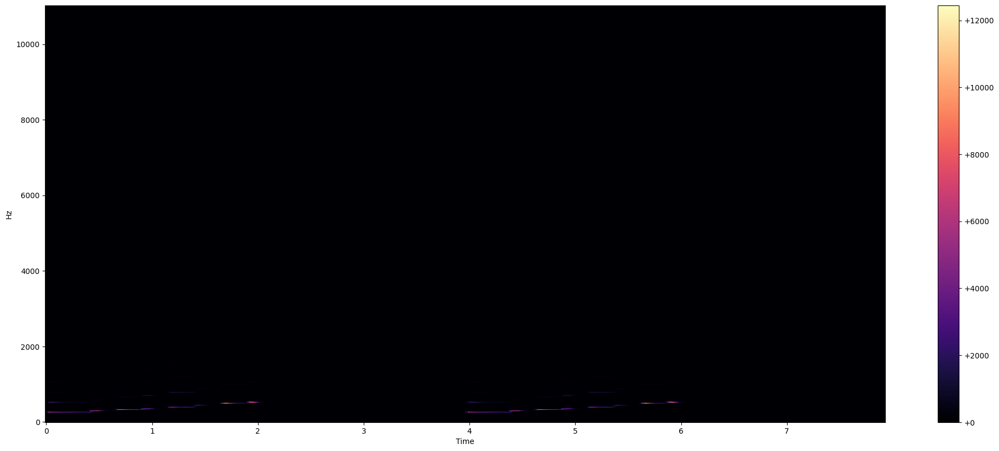

In [16]:
plot_spectrogram(Y_scale, sr, HOP_SIZE)

## Log-Amplitude Spectrogram

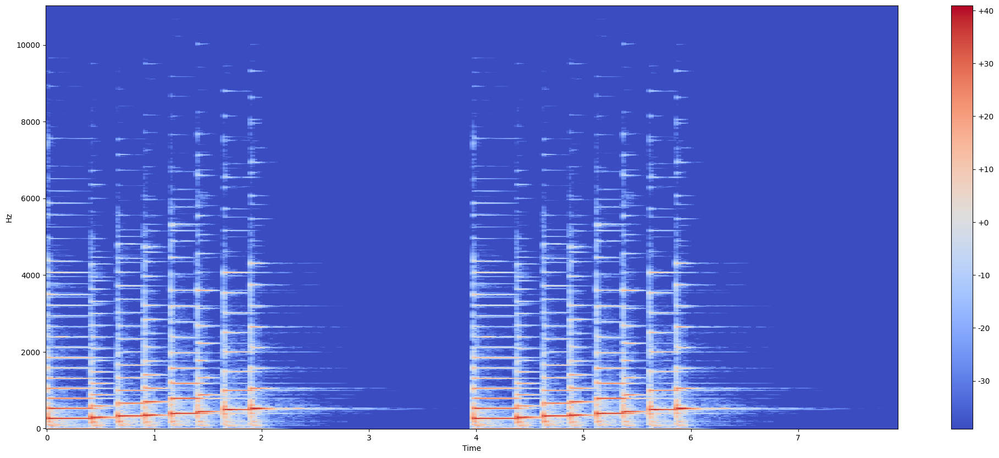

In [17]:
Y_log_scale = librosa.power_to_db(Y_scale)#将 功率谱（Y_scale） 转换为 分贝（dB）尺度，得到 对数尺度的功率谱
plot_spectrogram(Y_log_scale, sr, HOP_SIZE)

## Log-Frequency Spectrogram

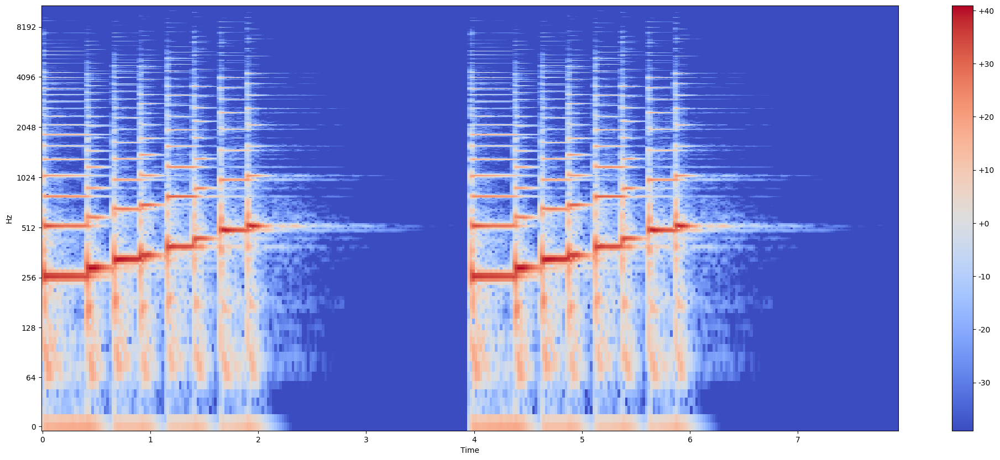

In [18]:
plot_spectrogram(Y_log_scale, sr, HOP_SIZE, y_axis='log')

## Visualising songs from different genres

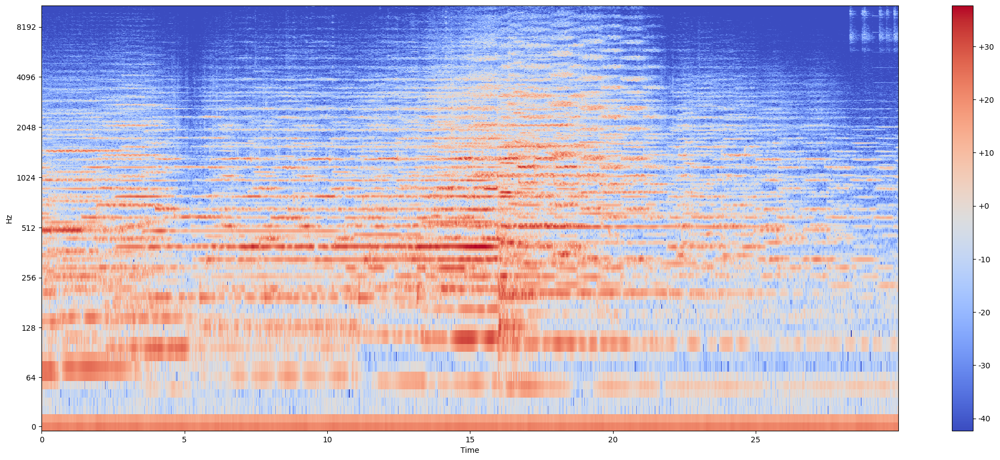

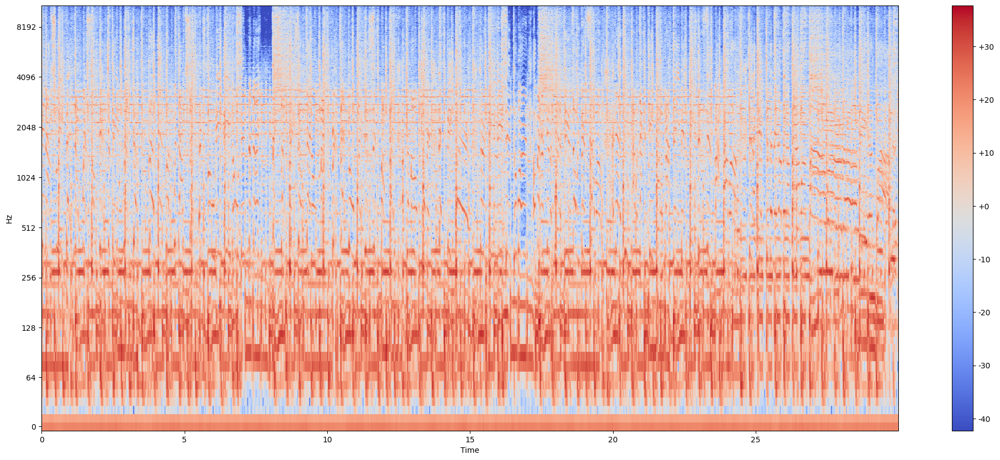

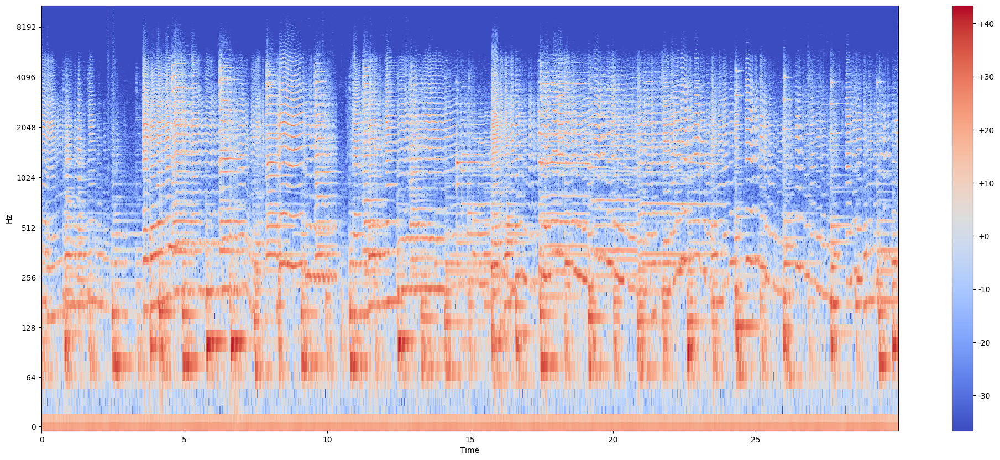

In [19]:
S_debussy = librosa.stft(debussy, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)#计算三个音频信号（debussy、redhot 和 duke）的短时傅里叶变换（STFT）
S_redhot = librosa.stft(redhot, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)
S_duke = librosa.stft(duke, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)


Y_debussy = librosa.power_to_db(np.abs(S_debussy) ** 2)#将 STFT 结果 转换为 对数尺度的功率谱
Y_redhot = librosa.power_to_db(np.abs(S_redhot) ** 2)
Y_duke = librosa.power_to_db(np.abs(S_duke) ** 2)

plot_spectrogram(Y_debussy, sr, HOP_SIZE, y_axis='log')
plot_spectrogram(Y_redhot, sr, HOP_SIZE, y_axis='log')
plot_spectrogram(Y_duke, sr, HOP_SIZE, y_axis='log')

## Extracting Short-Time Fourier Transform with Torch and Torchaudio

In [20]:
import torchaudio

%matplotlib inline

In [21]:
scale_file = 'audio/scale.wav'
debussy_file = 'audio/debussy.wav'
redhot_file = 'audio/redhot.wav'
duke_file = 'audio/duke.wav'

In [22]:
scale_torchaudio, sr_torchaudio = torchaudio.load(scale_file)#加载音频文件
scale_resampler = torchaudio.transforms.Resample(orig_freq=sr_torchaudio, new_freq=sr)#将音频信号的采样率从原始采样率 sr_torchaudio 转换为目标采样率 sr
scale_torchaudio = scale_resampler(scale_torchaudio.mean(dim=0).unsqueeze(0))#去除多余的声道并调整形状

sr_torchaudio = sr#更新采样率变量

In [23]:
print(scale_torchaudio.shape)
print(scale_torchaudio.dim())

torch.Size([1, 174943])
2


In [24]:
# duration in seconds of 1 sample
sample_duration = 1 / sr_torchaudio
print(f'One sample lasts for {sample_duration:.8f} seconds')

One sample lasts for 0.00004535 seconds


In [25]:
# total number of samples in audio file
tot_samples = scale_torchaudio.size(1)#获取音频信号 scale_torchaudio 的总样本数
print(tot_samples)

174943


In [26]:
# duration of debussy audio in seconds
duration = 1 / sr_torchaudio * tot_samples#计算音频信号的时长
print(f'The audio lasts for {duration} seconds')

The audio lasts for 7.933922902494332 seconds


In [27]:
stft_transform = torchaudio.transforms.Spectrogram(n_fft=FRAME_SIZE, hop_length=HOP_SIZE, pad_mode='constant')#提供的一个转换器，用于计算音频信号的 频谱（Spectrogram）
Y_scale_torchaudio = stft_transform(scale_torchaudio).squeeze(0)#将音频信号 scale_torchaudio 输入到 STFT 转换器中，计算该信号的 频谱（Spectrogram）

In [28]:
print(Y_scale_torchaudio.shape)

torch.Size([1025, 342])


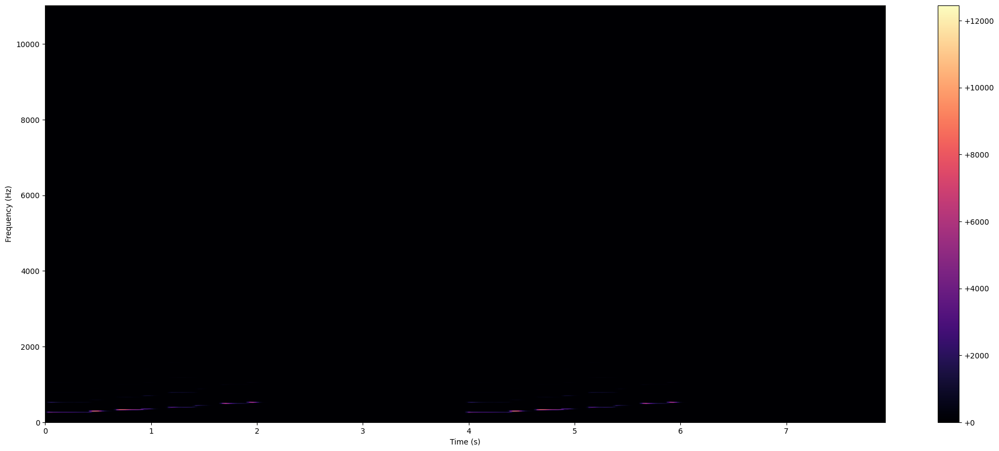

In [29]:
plt.figure(figsize=(25, 10))
plt.imshow(Y_scale_torchaudio, aspect='auto', origin='lower', cmap='magma', extent=(0, duration, 0, sr_torchaudio // 2))#显示音频信号的频谱图，将 Y_scale_torchaudio 的数据可视化为热力图
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(format='%+2.f')
plt.show()

In [30]:
spectrogram_transform = torchaudio.transforms.AmplitudeToDB(stype='power', top_db=80)#创建了一个 振幅到分贝（dB） 的转换器 spectrogram_transform，用于将频谱的振幅表示转换为 dB（分贝） 表示
Y_log_scale_torchaudio = spectrogram_transform(Y_scale_torchaudio).squeeze(0)#将音频信号的功率谱 Y_scale_torchaudio 转换为 分贝（dB） 表示，并移除不需要的维度

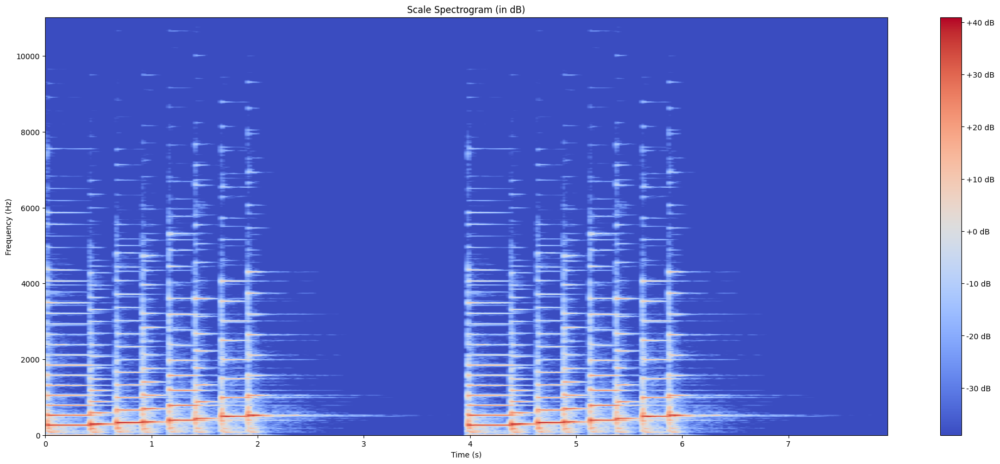

In [31]:
plt.figure(figsize=(25, 10))
plt.imshow(Y_log_scale_torchaudio, aspect='auto', origin='lower', cmap='coolwarm', extent=(0, duration, 0, sr_torchaudio / 2))
plt.colorbar(format='%+2.f dB')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.title('Scale Spectrogram (in dB)')
plt.show()

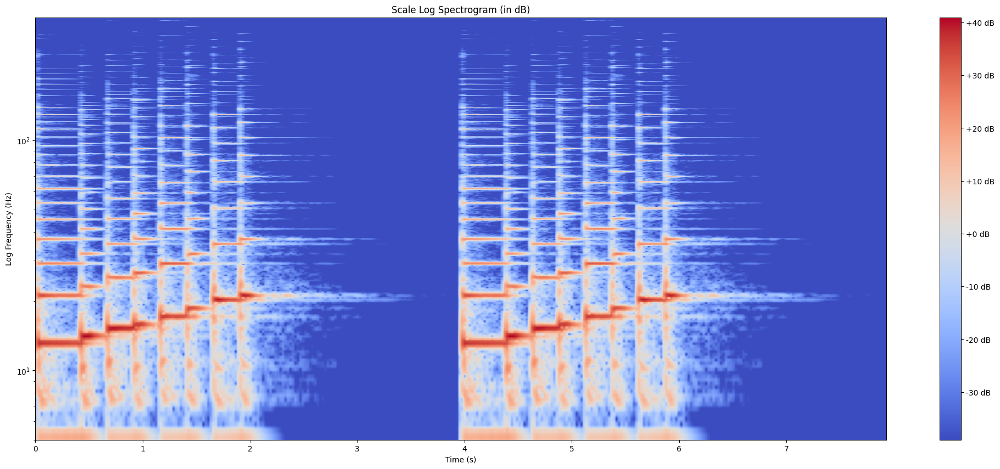

In [32]:
plt.figure(figsize=(25, 10))
plt.yscale('log')
plt.imshow(Y_log_scale_torchaudio, aspect='auto', origin='lower', cmap='coolwarm', extent=(0, duration, 5, Y_log_scale_torchaudio.size(1)))
plt.colorbar(format='%+2.f dB')
plt.xlabel('Time (s)')
plt.ylabel('Log Frequency (Hz)')
plt.title('Scale Log Spectrogram (in dB)')
plt.show()

In [33]:
debussy_torchaudio, _ = torchaudio.load(debussy_file)
redhot_torchaudio, _ = torchaudio.load(redhot_file)
duke_torchaudio, _ = torchaudio.load(duke_file)

In [34]:
print(debussy_torchaudio.shape)
print(debussy_torchaudio.dim())

torch.Size([1, 661500])
2


In [35]:
# total number of samples in audio file
tot_samples = debussy_torchaudio.size(1)
print(tot_samples)

661500


In [36]:
# duration of debussy audio in seconds
duration = 1 / sr_torchaudio * tot_samples
print(f'The audio lasts for {duration} seconds')

The audio lasts for 30.0 seconds


In [37]:
Y_debussy_torchaudio = stft_transform(debussy_torchaudio).squeeze(0)#三个音频信号（debussy_torchaudio、redhot_torchaudio 和 duke_torchaudio）分别进行短时傅里叶变换（STFT），以获取它们的频谱数据，并移除多余的维度
Y_redhot_torchaudio = stft_transform(redhot_torchaudio).squeeze(0)
Y_duke_torchaudio = stft_transform(duke_torchaudio).squeeze(0)

Y_log_debussy_torchaudio = spectrogram_transform(Y_debussy_torchaudio).squeeze(0)#将三个音频信号的功率谱 Y_debussy_torchaudio、Y_redhot_torchaudio 和 Y_duke_torchaudio 转换为分贝（dB）表示
Y_log_redhot_torchaudio = spectrogram_transform(Y_redhot_torchaudio).squeeze(0)
Y_log_duke_torchaudio = spectrogram_transform(Y_duke_torchaudio).squeeze(0)

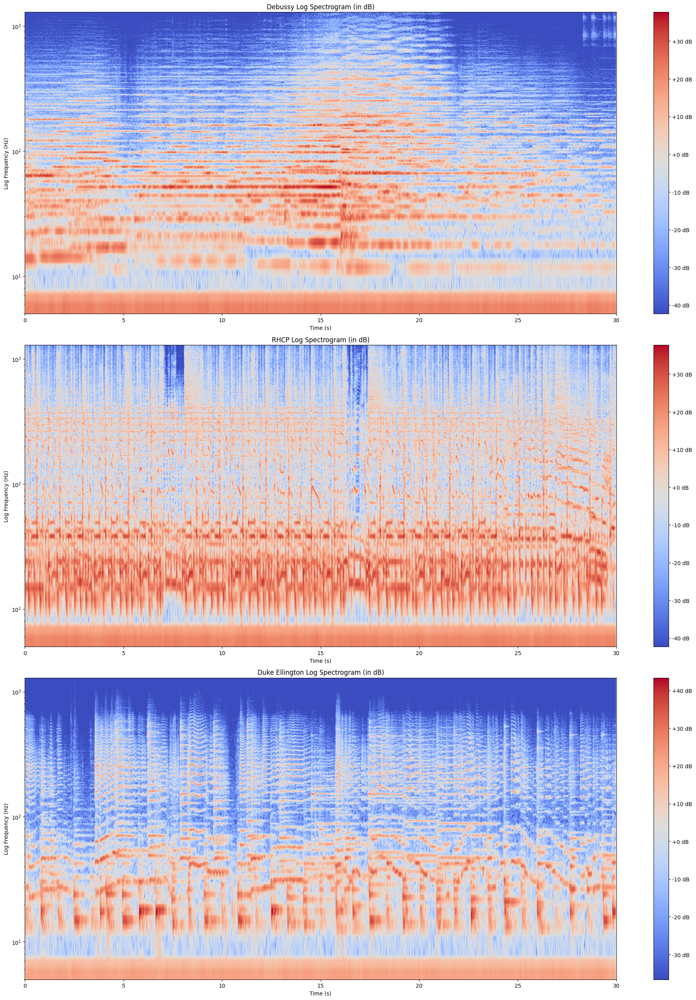

In [38]:
plt.figure(figsize=(20, 26))

# Debussy
plt.subplot(3, 1, 1)
plt.yscale('log')
plt.imshow(Y_log_debussy_torchaudio, aspect='auto', origin='lower', cmap='coolwarm', extent=(0, duration, 5, Y_log_debussy_torchaudio.size(1)))
plt.colorbar(format='%+2.f dB')
plt.title('Debussy Log Spectrogram (in dB)')
plt.xlabel('Time (s)')
plt.ylabel('Log Frequency (Hz)')

# Redhot
plt.subplot(3, 1, 2)
plt.yscale('log')
plt.imshow(Y_log_redhot_torchaudio, aspect='auto', origin='lower', cmap='coolwarm', extent=(0, duration, 5, Y_log_redhot_torchaudio.size(1)))
plt.colorbar(format='%+2.f dB')
plt.title('RHCP Log Spectrogram (in dB)')
plt.xlabel('Time (s)')
plt.ylabel('Log Frequency (Hz)')

# Duke
plt.subplot(3, 1, 3)
plt.yscale('log')
plt.imshow(Y_log_duke_torchaudio, aspect='auto', origin='lower', cmap='coolwarm', extent=(0, duration, 5, Y_log_duke_torchaudio.size(1)))
plt.colorbar(format='%+2.f dB')
plt.title('Duke Ellington Log Spectrogram (in dB)')
plt.xlabel('Time (s)')
plt.ylabel('Log Frequency (Hz)')

plt.tight_layout()
plt.show()